<a href="https://colab.research.google.com/github/Evgen-Shah/YOLOV5_WORKS/blob/main/DetectBubble.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Подключил необходимые библиотеки 

In [ ]:
import cv2
from PIL import Image
import numpy as np
import requests
from google.colab.patches import cv2_imshow
import inspect
import math
from math import sqrt
import imutils
from google.colab import drive
drive.mount('/content/drive')
from google.colab import files
from PIL import Image
from io import BytesIO
from IPython.display import display

Mounted at /content/drive


In [ ]:
!python /content/drive/MyDrive/contentBuble/yolov5/train.py --img 640 --batch 16 --epochs 100 --data /content/drive/MyDrive/contentBuble/yolov5/data/custom_date.yaml --weights /content/drive/MyDrive/contentBuble/yolov5/yolov5s.pt --cache

train: weights=/content/drive/MyDrive/contentBuble/yolov5/yolov5s.pt, cfg=, data=/content/drive/MyDrive/contentBuble/yolov5/data/custom_date.yaml, hyp=drive/MyDrive/contentBuble/yolov5/data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=640, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=drive/MyDrive/contentBuble/yolov5/runs/train, name=exp, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
Command 'git fetch && git config --get remote.origin.url' timed out after 5 seconds
YOLOv5 🚀 v6.1-69-g7830e91 torch 1.10.0+cu111 CPU

remote: Enumerating objects: 376, done.
remote: Counting objects: 100% (172/172), done.
remote: Compressing objects: 100% (15/15), done.
h

In [ ]:
!python /content/drive/MyDrive/contentBuble/yolov5/detect.py --weights /content/drive/MyDrive/contentBuble/yolov5/runs/train/exp/weights/last.pt --img 1080 --conf 0.6 --source /content/drive/MyDrive/contentBuble/yolov5/data/images --save-txt


detect: weights=['/content/drive/MyDrive/contentBuble/yolov5/runs/train/exp/weights/last.pt'], source=/content/drive/MyDrive/contentBuble/yolov5/data/images, data=drive/MyDrive/contentBuble/yolov5/data/coco128.yaml, imgsz=[1080, 1080], conf_thres=0.6, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=True, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=drive/MyDrive/contentBuble/yolov5/runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False
YOLOv5 🚀 v6.1-69-g7830e91 torch 1.10.0+cu111 CPU

Fusing layers... 
Model summary: 213 layers, 7012822 parameters, 0 gradients
image 1/7 /content/drive/MyDrive/contentBuble/yolov5/data/images/1.jpg: 864x1088 2 bubbles, Done. (1.179s)
image 2/7 /content/drive/MyDrive/contentBuble/yolov5/data/images/2.jpg: 928x1088 8 bubbles, Done. (1.115s)
image 3/7 /content/drive/MyDrive/contentBuble/yolov5

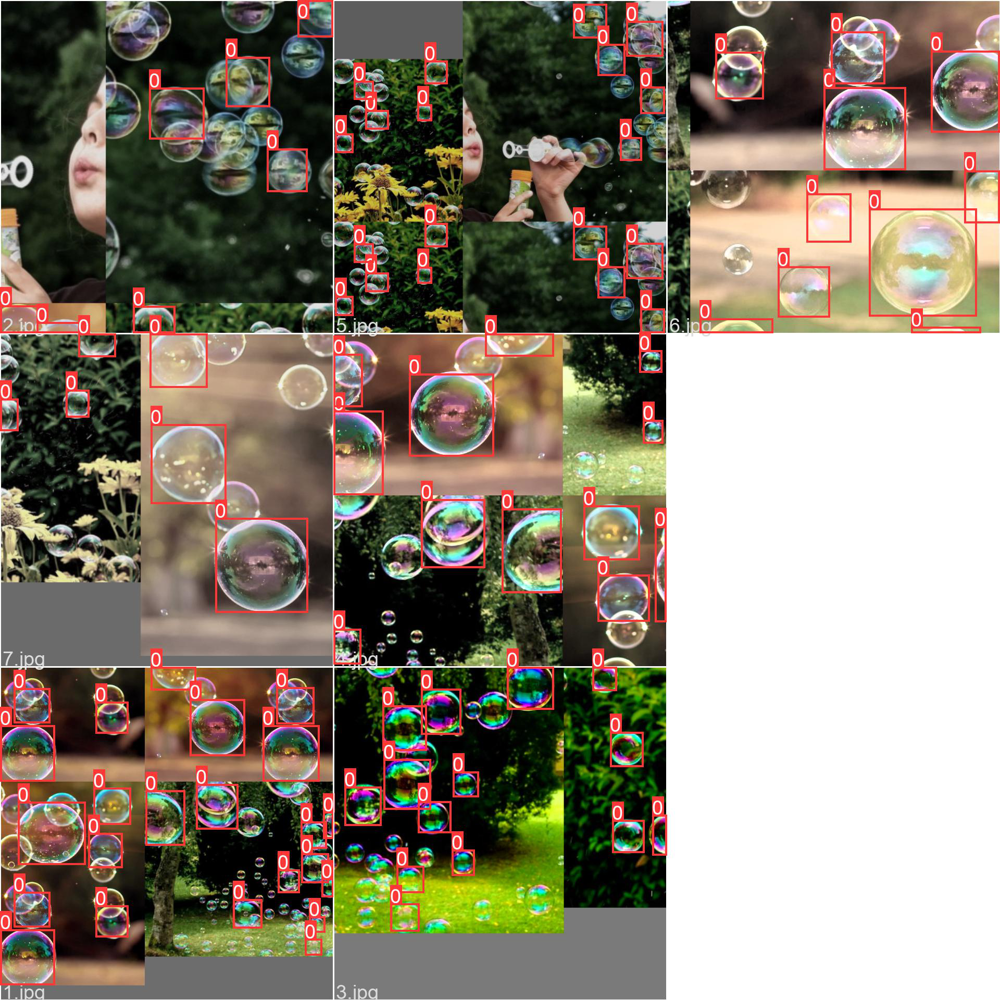

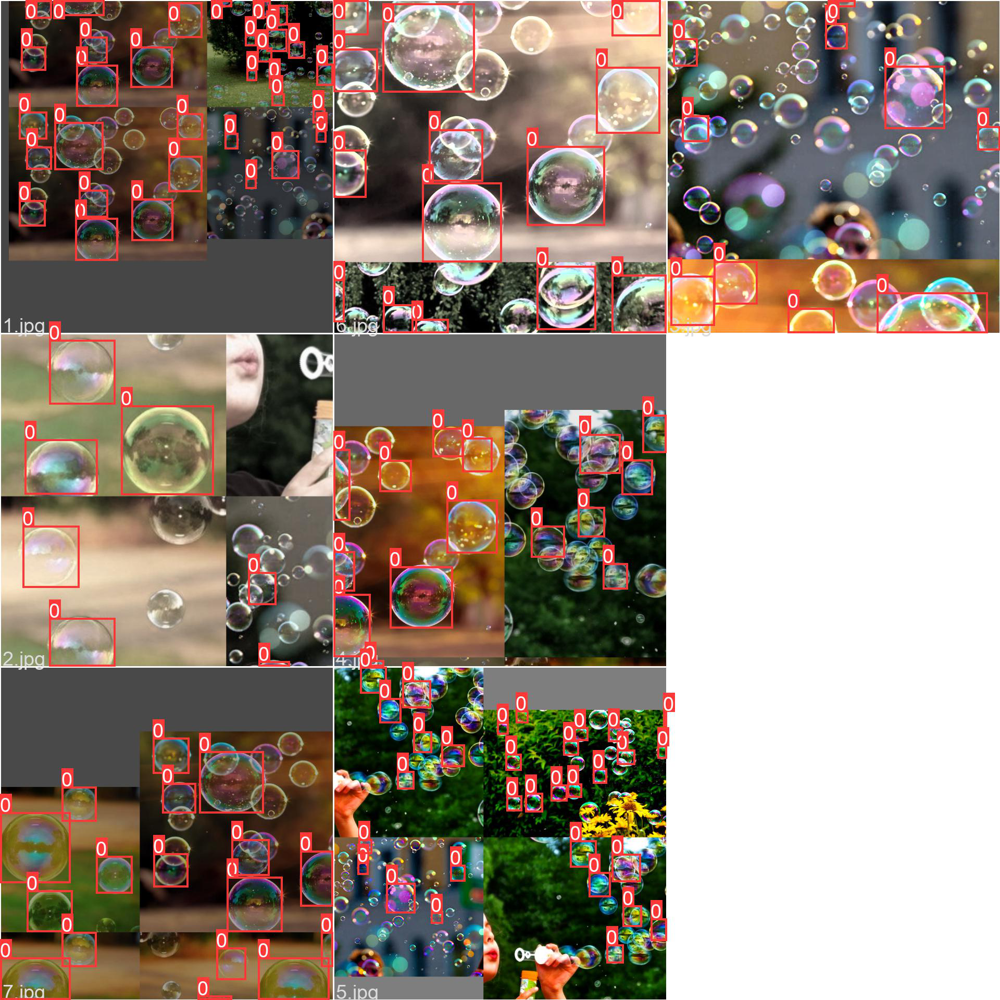

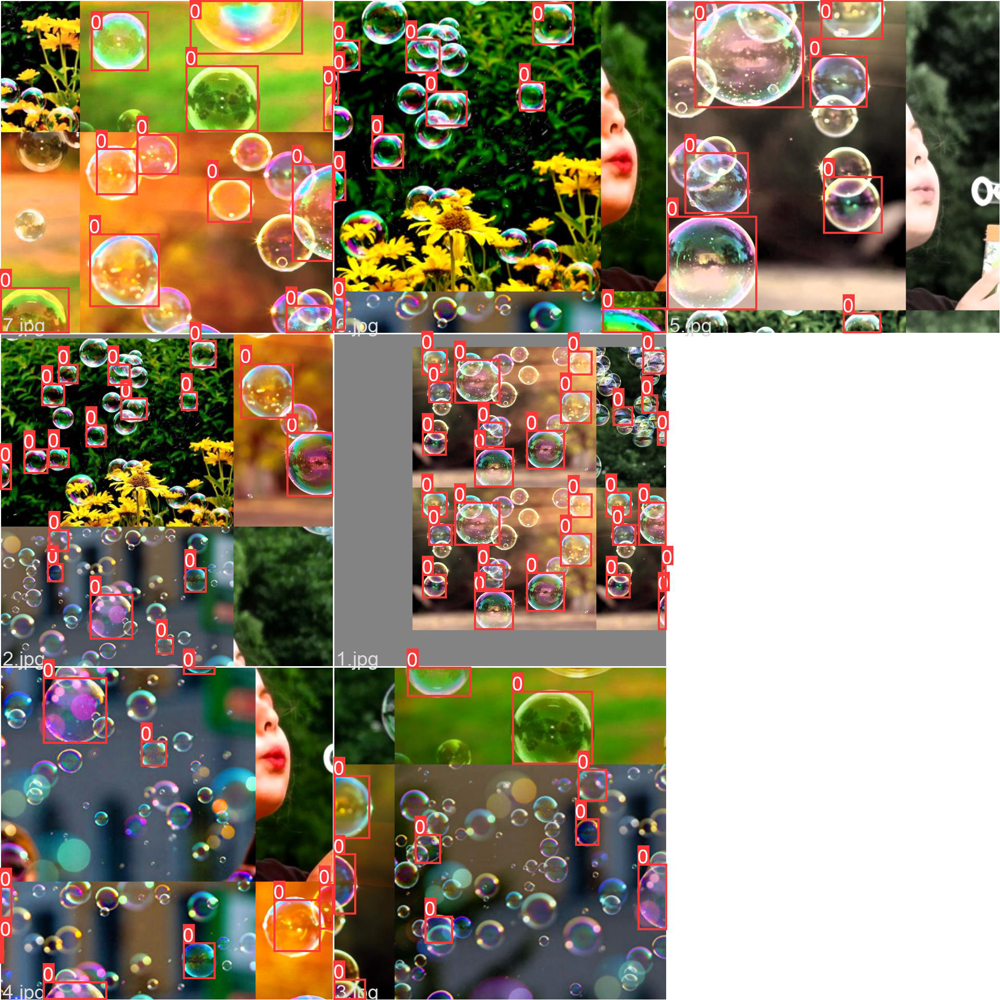

In [ ]:
path="/content/drive/MyDrive/contentBuble/yolov5/runs/train/exp"
ai = Image.open(path+'/train_batch2.jpg')
display(ai)
ai = Image.open(path+'/train_batch1.jpg')
display(ai)
ai = Image.open(path+'/train_batch0.jpg')
display(ai)

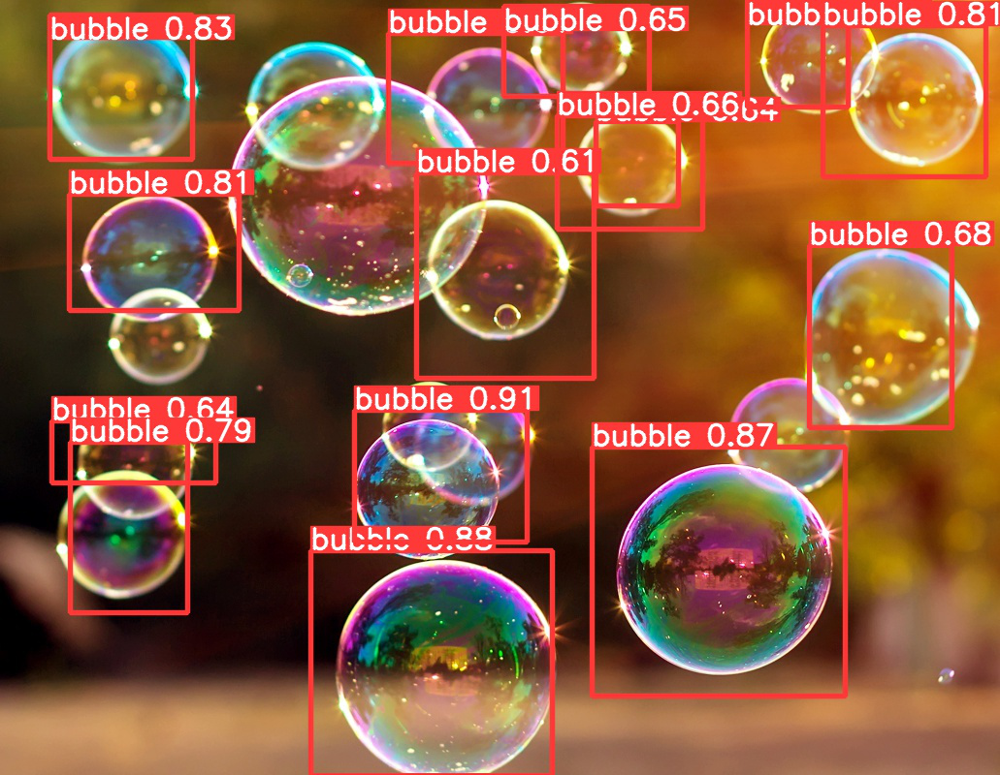

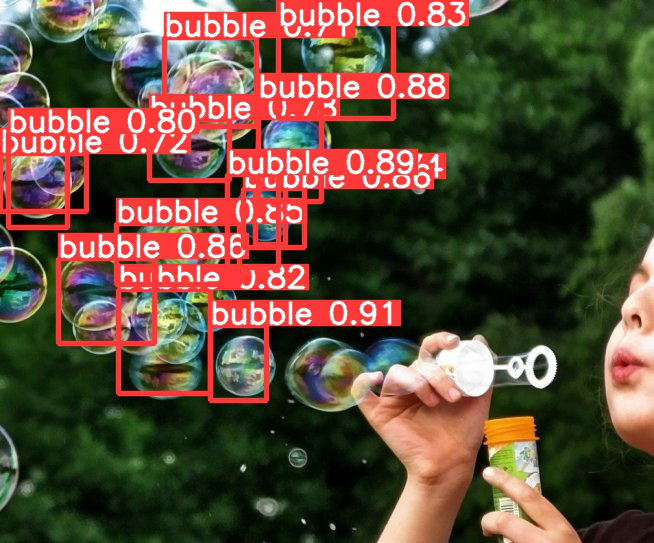

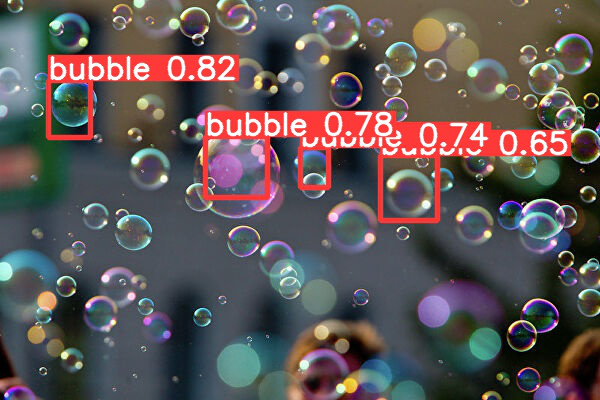

In [ ]:
path="/content/drive/MyDrive/contentBuble/yolov5/runs/detect/exp3"
ai = Image.open(path+'/1.jpg')
display(ai)
ai = Image.open(path+'/2.jpg')
display(ai)
ai = Image.open(path+'/3.jpg')
display(ai)
ai = Image.open(path+'/4.jpg')
display(ai)

7


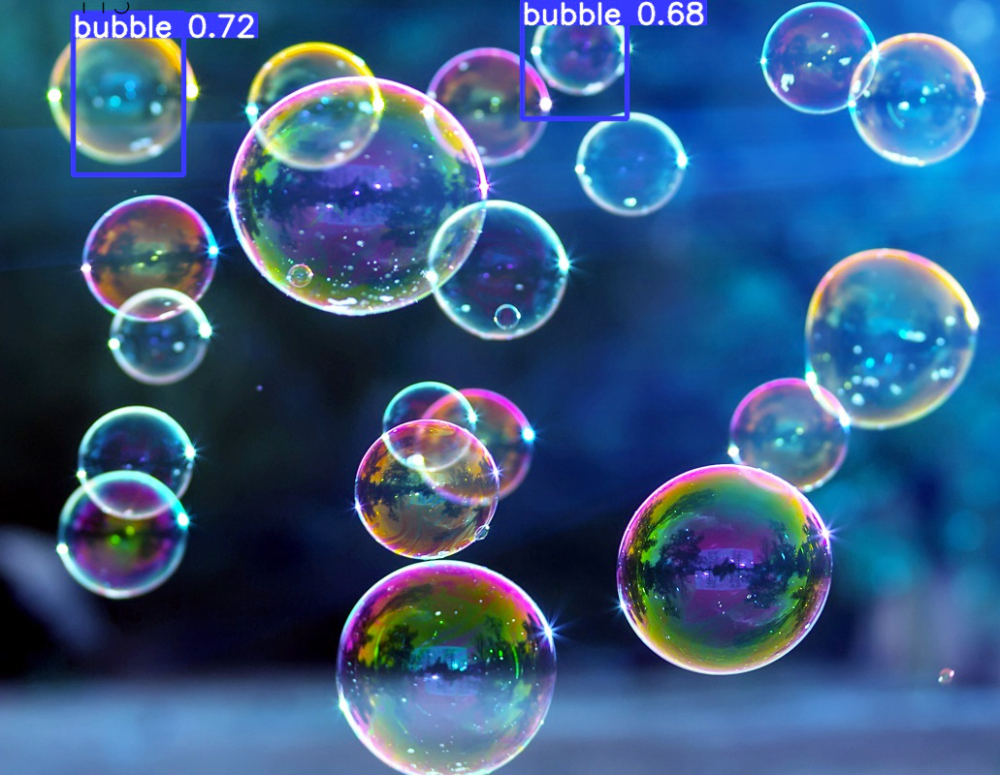

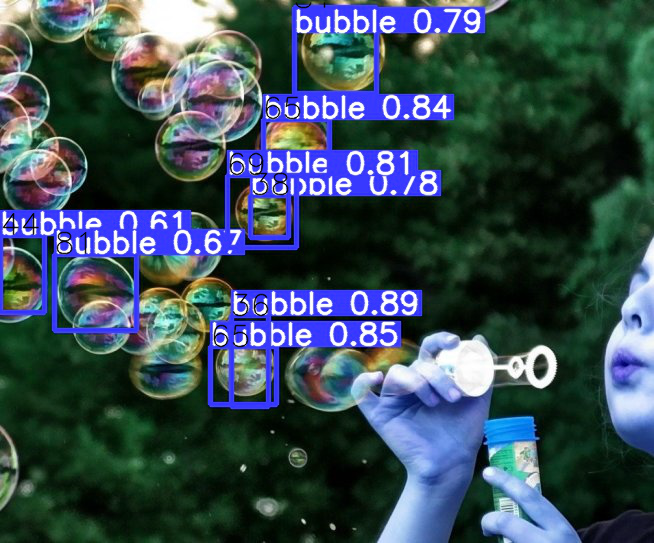

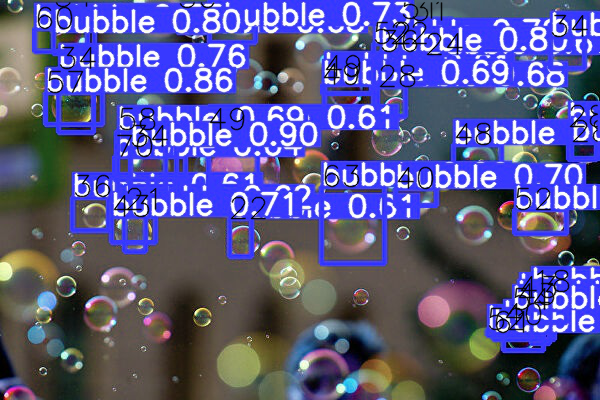

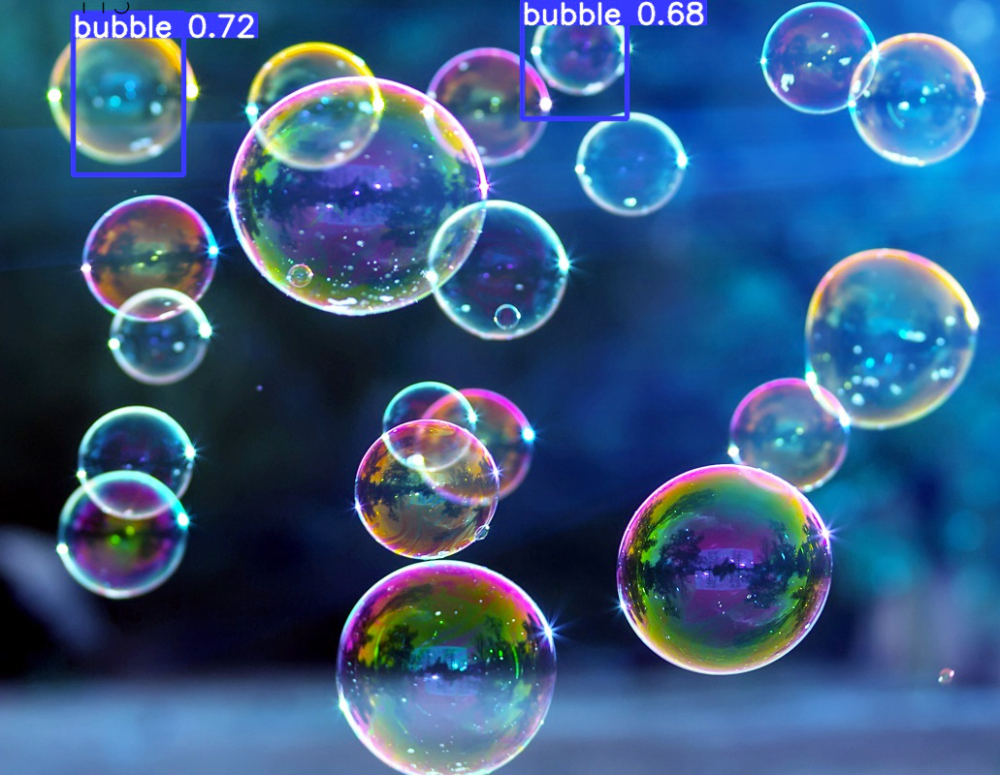

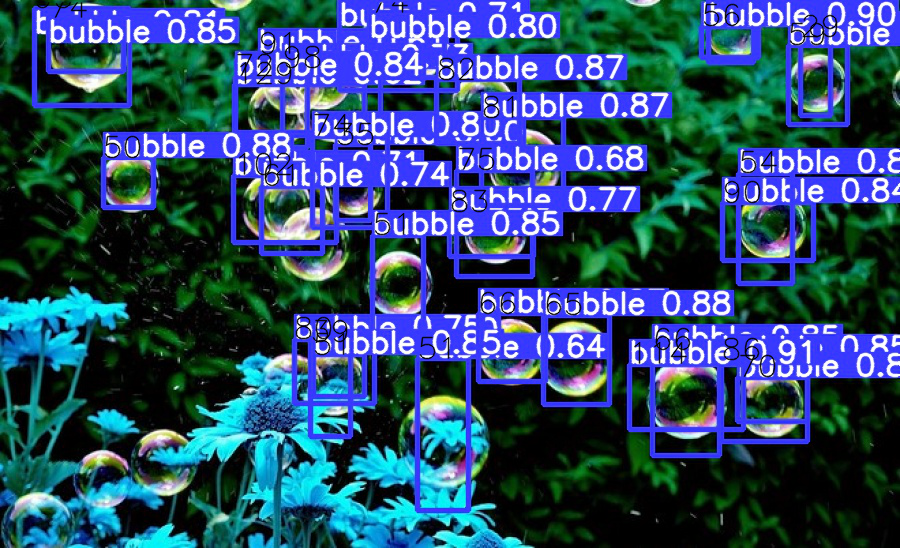

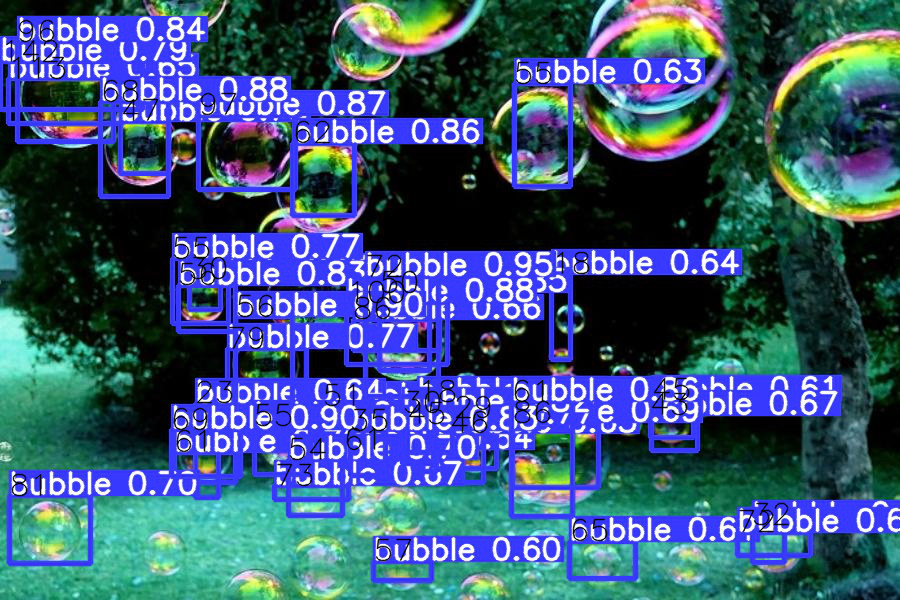

In [ ]:
import os.path
numberExp = 5 
pathIm="/content/drive/MyDrive/contentBuble/yolov5/runs/detect/exp"+str(numberExp)

num_files = sum(os.path.isfile(os.path.join(pathIm, f)) for f in os.listdir(pathIm)) 
print(num_files)
# height - высота
# weight - ширина

#<labels> <x> <y> <width> <height>

path="/content/drive/MyDrive/contentBuble/yolov5/runs/detect/exp"+str(numberExp)+"/labels"
for i in range(1,num_files):
  ai = Image.open(pathIm+'/'+ str(i) +'.jpg')
  ai = np.array(ai)

  dh,dw, _ = ai.shape

  file1 = open(path + '/'+ str(i) +'.txt',"r")
  for string in file1:

    _, x, y, w, h = map(float, string.split(' '))
    

    x = int((x - w / 2) * dw)
    w = int(w * dw)
    y = int((y - h / 2) * dh)
    h = int(h * dh)

    cv2.putText(ai, str(w), (x, y),cv2.FONT_HERSHEY_SIMPLEX,1, (0, 0, 0), 1,cv2.LINE_AA)
  cv2_imshow(ai)